In [1]:
%load_ext autoreload
%autoreload 2


In [2]:
from utils import device
import matplotlib.pyplot as plt
from torchvision import transforms
import torchvision
import torch

/opt/conda/lib/python3.7/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: /opt/conda/lib/python3.7/site-packages/torchvision/image.so: undefined symbol: _ZN2at4_ops19empty_memory_format4callEN3c108ArrayRefIlEENS2_8optionalINS2_10ScalarTypeEEENS5_INS2_6LayoutEEENS5_INS2_6DeviceEEENS5_IbEENS5_INS2_12MemoryFormatEEE
  warn(f"Failed to load image Python extension: {e}")


In [3]:
torch.backends.cuda.matmul.allow_tf32 = True
torch.backends.cudnn.allow_tf32 = True

In [4]:
from utils import ImageDataset, ConvResNet, init_dataloader, channel_binary_mask, \
    checkerboard_binary_mask, AffineCouplingLayer, RealNVP, Scale, FinalScale
import torch
from torch.distributions.normal import Normal
from math import log
device = torch.device(device)

In [5]:
# celebA_train_dataset = torchvision.datasets.CelebA(root="/home/ext_amin_unity3d_com/real_nvp_data_celebA",
#                                                    split="train",
#                                                    download=True,
#                                                    transform=transforms.Compose([transforms.ToTensor()])
#                                                    )

In [6]:
# celebA_train_dataloader = torch.utils.data.DataLoader(celebA_train_dataset, batch_size=64)

In [7]:
lsun_train_dataset = ImageDataset(root_dir="/home/ext_amin_unity3d_com/real_nvp_data/train")
lsun_train_dataloader = init_dataloader(lsun_train_dataset)

In [8]:
dataset = lsun_train_dataset
dataloader = lsun_train_dataloader

In [9]:
tmp_input = torch.ones(5, 3, 32, 32).to(device)
tmp_input_split = torch.ones(5, 6, 16, 16).to(device)

In [10]:
scale = Scale().to(device=device)
forwarded_scale, _  = scale(tmp_input)
reversed_scale = scale.reverse(forwarded_scale)
print(torch.norm(tmp_input - reversed_scale))

tensor(nan, device='cuda:0', grad_fn=<NormBackward1>)


In [11]:
final_scale = FinalScale().to(device)
forwarded_fs, _ = final_scale(tmp_input_split)
reversed_fs = final_scale.reverse(forwarded_fs)
print(torch.norm(tmp_input_split - reversed_fs))

tensor(1.3636, device='cuda:0', grad_fn=<NormBackward1>)


In [12]:
def save_plot(n_row, n_column, generated_image, epoch, path):
    fig, ax = plt.subplots(n_row, n_column, squeeze=True)
    fig.subplots_adjust(wspace=.02, hspace=.02)
    for i in range(0, n_row):
        for j in range (0, n_column):
            ax[i, j].axis("off")
            image = (generated_image[i, j].permute([1, 2, 0]).detach().cpu().numpy())
            _ = ax[i, j].imshow(image, aspect="auto")
    plt.suptitle(f"generated_plot epoch {epoch}")
    fig.savefig(f"{path}/generated_image_epoch_{epoch}.png")

In [13]:
realnvp = RealNVP().to(device)
print(f"number of parameters in the model {sum([p.numel() for p in realnvp.parameters()])}")
optimizer = torch.optim.Adam(lr=1e-3, params=realnvp.parameters())

number of parameters in the model 497890


epcoh 0, batch 0, loss 18.06173324584961
epcoh 0, batch 99, loss 6.940193176269531
epcoh 0, batch 198, loss 6.148392200469971
epcoh 0, batch 297, loss 5.627474784851074
epcoh 0, batch 396, loss 5.142551898956299
epcoh 0, batch 495, loss 5.0688018798828125
epcoh 0, batch 594, loss 4.881494045257568
epcoh 0, batch 693, loss 4.617733001708984
epcoh 0, batch 792, loss 4.559094429016113
epcoh 0, batch 891, loss 4.613811016082764
epoch 0, loss: 5.556916236877441


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 1, batch 0, loss 4.428048610687256
epcoh 1, batch 99, loss 4.484305381774902
epcoh 1, batch 198, loss 4.45425271987915
epcoh 1, batch 297, loss 4.337318420410156
epcoh 1, batch 396, loss 4.295107841491699
epcoh 1, batch 495, loss 4.334385871887207
epcoh 1, batch 594, loss 4.300874710083008
epcoh 1, batch 693, loss 4.206007957458496
epcoh 1, batch 792, loss 4.157846450805664
epcoh 1, batch 891, loss 4.2613396644592285
epoch 1, loss: 4.339138984680176


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 2, batch 0, loss 4.236814022064209
epcoh 2, batch 99, loss 4.211522102355957
epcoh 2, batch 198, loss 4.209019660949707
epcoh 2, batch 297, loss 4.247676372528076
epcoh 2, batch 396, loss 4.178948402404785
epcoh 2, batch 495, loss 4.2700395584106445
epcoh 2, batch 594, loss 4.13587760925293
epcoh 2, batch 693, loss 4.205509662628174
epcoh 2, batch 792, loss 4.142521858215332
epcoh 2, batch 891, loss 4.1706624031066895
epoch 2, loss: 4.191849231719971


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 3, batch 0, loss 4.232222557067871
epcoh 3, batch 99, loss 4.070531845092773
epcoh 3, batch 198, loss 4.142524242401123
epcoh 3, batch 297, loss 4.093868255615234
epcoh 3, batch 396, loss 4.048719882965088
epcoh 3, batch 495, loss 4.087273597717285
epcoh 3, batch 594, loss 4.068359851837158
epcoh 3, batch 693, loss 4.10051155090332
epcoh 3, batch 792, loss 4.239333152770996
epcoh 3, batch 891, loss 4.012173652648926
epoch 3, loss: 4.1168317794799805


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 4, batch 0, loss 4.086848258972168
epcoh 4, batch 99, loss 4.035742282867432
epcoh 4, batch 198, loss 4.082561492919922
epcoh 4, batch 297, loss 4.0209760665893555
epcoh 4, batch 396, loss 4.010102272033691
epcoh 4, batch 495, loss 4.029414176940918
epcoh 4, batch 594, loss 4.034725189208984
epcoh 4, batch 693, loss 4.033359050750732
epcoh 4, batch 792, loss 3.9979729652404785
epcoh 4, batch 891, loss 4.0369110107421875
epoch 4, loss: 4.064785003662109


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 5, batch 0, loss 4.119752883911133
epcoh 5, batch 99, loss 4.099413871765137
epcoh 5, batch 198, loss 3.9715774059295654
epcoh 5, batch 297, loss 4.074877738952637
epcoh 5, batch 396, loss 4.004587650299072
epcoh 5, batch 495, loss 3.9798107147216797
epcoh 5, batch 594, loss 3.9406723976135254
epcoh 5, batch 693, loss 3.9616379737854004
epcoh 5, batch 792, loss 4.04467248916626
epcoh 5, batch 891, loss 4.070599555969238
epoch 5, loss: 4.0244245529174805


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 6, batch 0, loss 4.010080337524414
epcoh 6, batch 99, loss 3.9739792346954346
epcoh 6, batch 198, loss 4.03911828994751
epcoh 6, batch 297, loss 3.958047389984131
epcoh 6, batch 396, loss 4.173347473144531
epcoh 6, batch 495, loss 4.10650634765625
epcoh 6, batch 594, loss 4.0387420654296875
epcoh 6, batch 693, loss 3.956756353378296
epcoh 6, batch 792, loss 3.956800937652588
epcoh 6, batch 891, loss 4.043670654296875
epoch 6, loss: 3.994197368621826


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 7, batch 0, loss 3.972933292388916
epcoh 7, batch 99, loss 4.043515205383301
epcoh 7, batch 198, loss 4.030865669250488
epcoh 7, batch 297, loss 3.975665330886841
epcoh 7, batch 396, loss 3.9580161571502686
epcoh 7, batch 495, loss 3.8874964714050293
epcoh 7, batch 594, loss 3.9484267234802246
epcoh 7, batch 693, loss 3.9443116188049316
epcoh 7, batch 792, loss 3.9565703868865967
epcoh 7, batch 891, loss 3.997138500213623
epoch 7, loss: 3.964661121368408


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 8, batch 0, loss 3.971519708633423
epcoh 8, batch 99, loss 4.03220272064209
epcoh 8, batch 198, loss 3.959418296813965
epcoh 8, batch 297, loss 3.939174175262451
epcoh 8, batch 396, loss 3.9491524696350098
epcoh 8, batch 495, loss 3.9499971866607666
epcoh 8, batch 594, loss 3.8981337547302246
epcoh 8, batch 693, loss 3.863797664642334
epcoh 8, batch 792, loss 3.870993137359619
epcoh 8, batch 891, loss 3.8878564834594727
epoch 8, loss: 3.94187068939209


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 9, batch 0, loss 3.9247775077819824
epcoh 9, batch 99, loss 3.915159225463867
epcoh 9, batch 198, loss 3.9791619777679443
epcoh 9, batch 297, loss 4.036713600158691
epcoh 9, batch 396, loss 3.988539218902588
epcoh 9, batch 495, loss 3.832475185394287
epcoh 9, batch 594, loss 3.9691171646118164
epcoh 9, batch 693, loss 3.868063449859619
epcoh 9, batch 792, loss 3.9317257404327393
epcoh 9, batch 891, loss 3.9574828147888184
epoch 9, loss: 3.9174082279205322


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 10, batch 0, loss 3.9469985961914062
epcoh 10, batch 99, loss 3.87119197845459
epcoh 10, batch 198, loss 3.93815541267395
epcoh 10, batch 297, loss 3.8959884643554688
epcoh 10, batch 396, loss 3.961029052734375
epcoh 10, batch 495, loss 3.8917484283447266
epcoh 10, batch 594, loss 3.8363020420074463
epcoh 10, batch 693, loss 3.8472421169281006
epcoh 10, batch 792, loss 3.945748805999756
epcoh 10, batch 891, loss 3.8938703536987305
epoch 10, loss: 3.898104190826416


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 11, batch 0, loss 3.9271960258483887
epcoh 11, batch 99, loss 3.8404107093811035
epcoh 11, batch 198, loss 3.9427051544189453
epcoh 11, batch 297, loss 3.8708133697509766
epcoh 11, batch 396, loss 3.8516552448272705
epcoh 11, batch 495, loss 3.893895149230957
epcoh 11, batch 594, loss 3.81710147857666
epcoh 11, batch 693, loss 3.8212366104125977
epcoh 11, batch 792, loss 3.9178900718688965
epcoh 11, batch 891, loss 3.8709583282470703
epoch 11, loss: 3.881301164627075


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 12, batch 0, loss 3.9501736164093018
epcoh 12, batch 99, loss 3.861142158508301
epcoh 12, batch 198, loss 3.8442463874816895
epcoh 12, batch 297, loss 3.8563976287841797
epcoh 12, batch 396, loss 3.833350896835327
epcoh 12, batch 495, loss 3.799774646759033
epcoh 12, batch 594, loss 3.8445487022399902
epcoh 12, batch 693, loss 3.8803114891052246
epcoh 12, batch 792, loss 3.8226723670959473
epcoh 12, batch 891, loss 3.904130697250366
epoch 12, loss: 3.8658580780029297


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 13, batch 0, loss 3.9438459873199463
epcoh 13, batch 99, loss 3.9024271965026855
epcoh 13, batch 198, loss 3.8625121116638184
epcoh 13, batch 297, loss 3.9169485569000244
epcoh 13, batch 396, loss 3.7690541744232178
epcoh 13, batch 495, loss 3.9692254066467285
epcoh 13, batch 594, loss 3.835341453552246
epcoh 13, batch 693, loss 3.848909616470337
epcoh 13, batch 792, loss 3.846067428588867
epcoh 13, batch 891, loss 3.8890247344970703
epoch 13, loss: 3.8525664806365967


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 14, batch 0, loss 3.775204658508301
epcoh 14, batch 99, loss 3.8849308490753174
epcoh 14, batch 198, loss 3.855813980102539
epcoh 14, batch 297, loss 3.810187339782715
epcoh 14, batch 396, loss 3.769345998764038
epcoh 14, batch 495, loss 3.907845973968506
epcoh 14, batch 594, loss 3.8435378074645996
epcoh 14, batch 693, loss 3.8239219188690186
epcoh 14, batch 792, loss 3.818419933319092
epcoh 14, batch 891, loss 3.807126760482788
epoch 14, loss: 3.8413808345794678


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 15, batch 0, loss 3.8177621364593506
epcoh 15, batch 99, loss 3.8467066287994385
epcoh 15, batch 198, loss 3.8811914920806885
epcoh 15, batch 297, loss 3.7571513652801514
epcoh 15, batch 396, loss 3.9089598655700684
epcoh 15, batch 495, loss 3.8522162437438965
epcoh 15, batch 594, loss 3.7958526611328125
epcoh 15, batch 693, loss 3.787987232208252
epcoh 15, batch 792, loss 3.927950382232666
epcoh 15, batch 891, loss 3.805098056793213
epoch 15, loss: 3.832916736602783


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 16, batch 0, loss 3.8007965087890625
epcoh 16, batch 99, loss 3.9095466136932373
epcoh 16, batch 198, loss 3.8502919673919678
epcoh 16, batch 297, loss 3.8528547286987305
epcoh 16, batch 396, loss 3.785046339035034
epcoh 16, batch 495, loss 3.7795915603637695
epcoh 16, batch 594, loss 3.790891408920288
epcoh 16, batch 693, loss 3.810882568359375
epcoh 16, batch 792, loss 3.847398281097412
epcoh 16, batch 891, loss 3.829813003540039
epoch 16, loss: 3.822679042816162


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 17, batch 0, loss 3.841691732406616
epcoh 17, batch 99, loss 3.7808380126953125
epcoh 17, batch 198, loss 3.804579734802246
epcoh 17, batch 297, loss 3.8437018394470215
epcoh 17, batch 396, loss 3.7740097045898438
epcoh 17, batch 495, loss 3.8035097122192383
epcoh 17, batch 594, loss 3.8245835304260254
epcoh 17, batch 693, loss 3.7946724891662598
epcoh 17, batch 792, loss 3.8265867233276367
epcoh 17, batch 891, loss 3.947232246398926
epoch 17, loss: 3.814316511154175


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 18, batch 0, loss 3.861757755279541
epcoh 18, batch 99, loss 3.7455883026123047
epcoh 18, batch 198, loss 3.793882369995117
epcoh 18, batch 297, loss 3.822176933288574
epcoh 18, batch 396, loss 3.7399063110351562
epcoh 18, batch 495, loss 3.7529587745666504
epcoh 18, batch 594, loss 3.7975940704345703
epcoh 18, batch 693, loss 3.817549705505371
epcoh 18, batch 792, loss 3.7639613151550293
epcoh 18, batch 891, loss 3.825948715209961
epoch 18, loss: 3.8064231872558594


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 19, batch 0, loss 3.780308723449707
epcoh 19, batch 99, loss 3.80544114112854
epcoh 19, batch 198, loss 3.901578903198242
epcoh 19, batch 297, loss 3.781255006790161
epcoh 19, batch 396, loss 3.8643550872802734
epcoh 19, batch 495, loss 3.8100953102111816
epcoh 19, batch 594, loss 3.7774271965026855
epcoh 19, batch 693, loss 3.783538341522217
epcoh 19, batch 792, loss 3.7943358421325684
epcoh 19, batch 891, loss 3.82645320892334
epoch 19, loss: 3.8007631301879883


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 20, batch 0, loss 3.8592376708984375
epcoh 20, batch 99, loss 3.7707908153533936
epcoh 20, batch 198, loss 3.8009896278381348
epcoh 20, batch 297, loss 3.7708117961883545
epcoh 20, batch 396, loss 3.7532496452331543
epcoh 20, batch 495, loss 3.716691017150879
epcoh 20, batch 594, loss 3.769050121307373
epcoh 20, batch 693, loss 3.8226242065429688
epcoh 20, batch 792, loss 3.831092357635498
epcoh 20, batch 891, loss 3.771855354309082
epoch 20, loss: 3.794218063354492


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clip

epcoh 21, batch 0, loss 3.7480030059814453
epcoh 21, batch 99, loss 3.874453067779541
epcoh 21, batch 198, loss 3.680694103240967
epcoh 21, batch 297, loss 3.796623945236206
epcoh 21, batch 396, loss 3.7253212928771973
epcoh 21, batch 495, loss 3.7807412147521973
epcoh 21, batch 594, loss 3.719775676727295
epcoh 21, batch 693, loss 3.7783727645874023
epcoh 21, batch 792, loss 3.7164978981018066
epcoh 21, batch 891, loss 3.768521308898926
epoch 21, loss: 3.788306713104248


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 22, batch 0, loss 3.8789408206939697
epcoh 22, batch 99, loss 3.7521815299987793
epcoh 22, batch 198, loss 3.7425689697265625
epcoh 22, batch 297, loss 3.6836049556732178
epcoh 22, batch 396, loss 3.7958595752716064
epcoh 22, batch 495, loss 3.7749953269958496
epcoh 22, batch 594, loss 3.78965425491333
epcoh 22, batch 693, loss 3.739788055419922
epcoh 22, batch 792, loss 3.7877707481384277
epcoh 22, batch 891, loss 3.74997615814209
epoch 22, loss: 3.7838058471679688


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 23, batch 0, loss 3.7212462425231934
epcoh 23, batch 99, loss 3.7863471508026123
epcoh 23, batch 198, loss 3.8501052856445312
epcoh 23, batch 297, loss 3.83172869682312
epcoh 23, batch 396, loss 3.7619431018829346
epcoh 23, batch 495, loss 3.7251715660095215
epcoh 23, batch 594, loss 3.8028383255004883
epcoh 23, batch 693, loss 3.7876925468444824
epcoh 23, batch 792, loss 3.750753402709961
epcoh 23, batch 891, loss 3.84383487701416
epoch 23, loss: 3.7776365280151367


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 24, batch 0, loss 3.7303807735443115
epcoh 24, batch 99, loss 3.6943459510803223
epcoh 24, batch 198, loss 3.7657456398010254
epcoh 24, batch 297, loss 3.7061119079589844
epcoh 24, batch 396, loss 3.7116916179656982
epcoh 24, batch 495, loss 3.7196543216705322
epcoh 24, batch 594, loss 3.7645740509033203
epcoh 24, batch 693, loss 3.79201078414917
epcoh 24, batch 792, loss 3.6703498363494873
epcoh 24, batch 891, loss 3.76417875289917
epoch 24, loss: 3.773998737335205


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 25, batch 0, loss 3.724015712738037
epcoh 25, batch 99, loss 3.7179298400878906
epcoh 25, batch 198, loss 3.8221957683563232
epcoh 25, batch 297, loss 3.7755002975463867
epcoh 25, batch 396, loss 3.766894817352295
epcoh 25, batch 495, loss 3.6723947525024414
epcoh 25, batch 594, loss 3.7653908729553223
epcoh 25, batch 693, loss 3.729973793029785
epcoh 25, batch 792, loss 3.7538866996765137
epcoh 25, batch 891, loss 3.802612066268921
epoch 25, loss: 3.7679569721221924


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 26, batch 0, loss 3.711885929107666
epcoh 26, batch 99, loss 3.780066967010498
epcoh 26, batch 198, loss 3.7322916984558105
epcoh 26, batch 297, loss 3.7563562393188477
epcoh 26, batch 396, loss 3.8177456855773926
epcoh 26, batch 495, loss 3.8363442420959473
epcoh 26, batch 594, loss 3.7192904949188232
epcoh 26, batch 693, loss 3.7553412914276123
epcoh 26, batch 792, loss 3.8686015605926514
epcoh 26, batch 891, loss 3.740114212036133
epoch 26, loss: 3.7615020275115967


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 27, batch 0, loss 3.7586159706115723
epcoh 27, batch 99, loss 3.755110740661621
epcoh 27, batch 198, loss 3.8329904079437256
epcoh 27, batch 297, loss 3.6852235794067383
epcoh 27, batch 396, loss 3.8246617317199707
epcoh 27, batch 495, loss 3.784158229827881
epcoh 27, batch 594, loss 3.713620185852051
epcoh 27, batch 693, loss 3.7219436168670654
epcoh 27, batch 792, loss 3.771134853363037
epcoh 27, batch 891, loss 3.7613773345947266
epoch 27, loss: 3.7564241886138916


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 28, batch 0, loss 3.7454240322113037
epcoh 28, batch 99, loss 3.7379701137542725
epcoh 28, batch 198, loss 3.7031447887420654
epcoh 28, batch 297, loss 3.7124483585357666
epcoh 28, batch 396, loss 3.7725985050201416
epcoh 28, batch 495, loss 3.8448235988616943
epcoh 28, batch 594, loss 3.7801382541656494
epcoh 28, batch 693, loss 3.833466053009033
epcoh 28, batch 792, loss 3.7154855728149414
epcoh 28, batch 891, loss 3.7794690132141113
epoch 28, loss: 3.752103090286255


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 29, batch 0, loss 3.695279598236084
epcoh 29, batch 99, loss 3.729310989379883
epcoh 29, batch 198, loss 3.742448329925537
epcoh 29, batch 297, loss 3.6821932792663574
epcoh 29, batch 396, loss 3.7059326171875
epcoh 29, batch 495, loss 3.7452361583709717
epcoh 29, batch 594, loss 3.738574981689453
epcoh 29, batch 693, loss 3.8087878227233887
epcoh 29, batch 792, loss 3.76273775100708
epcoh 29, batch 891, loss 3.7516822814941406
epoch 29, loss: 3.7493350505828857


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 30, batch 0, loss 3.797520875930786
epcoh 30, batch 99, loss 3.7916629314422607
epcoh 30, batch 198, loss 3.7145254611968994
epcoh 30, batch 297, loss 3.744889736175537
epcoh 30, batch 396, loss 3.7522311210632324
epcoh 30, batch 495, loss 3.728135824203491
epcoh 30, batch 594, loss 3.710160255432129
epcoh 30, batch 693, loss 3.677809715270996
epcoh 30, batch 792, loss 3.746030330657959
epcoh 30, batch 891, loss 3.743499279022217
epoch 30, loss: 3.744262933731079


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 31, batch 0, loss 3.7592902183532715
epcoh 31, batch 99, loss 3.7022504806518555
epcoh 31, batch 198, loss 3.7250680923461914
epcoh 31, batch 297, loss 3.7202911376953125
epcoh 31, batch 396, loss 3.7135469913482666
epcoh 31, batch 495, loss 3.726168632507324
epcoh 31, batch 594, loss 3.756728172302246
epcoh 31, batch 693, loss 3.741908311843872
epcoh 31, batch 792, loss 3.7750816345214844
epcoh 31, batch 891, loss 3.7613401412963867
epoch 31, loss: 3.740205764770508


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 32, batch 0, loss 3.7420473098754883
epcoh 32, batch 99, loss 3.744382858276367
epcoh 32, batch 198, loss 3.7943003177642822
epcoh 32, batch 297, loss 3.761641025543213
epcoh 32, batch 396, loss 3.7173514366149902
epcoh 32, batch 495, loss 3.7006311416625977
epcoh 32, batch 594, loss 3.7478556632995605
epcoh 32, batch 693, loss 3.7445437908172607
epcoh 32, batch 792, loss 3.711801052093506
epcoh 32, batch 891, loss 3.687222719192505
epoch 32, loss: 3.7387773990631104


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 33, batch 0, loss 3.8452751636505127
epcoh 33, batch 99, loss 3.7329108715057373
epcoh 33, batch 198, loss 3.7826972007751465
epcoh 33, batch 297, loss 3.743412494659424
epcoh 33, batch 396, loss 3.772913932800293
epcoh 33, batch 495, loss 3.737879514694214
epcoh 33, batch 594, loss 3.7747018337249756
epcoh 33, batch 693, loss 3.6407806873321533
epcoh 33, batch 792, loss 3.7172369956970215
epcoh 33, batch 891, loss 3.7351012229919434
epoch 33, loss: 3.7350916862487793


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 34, batch 0, loss 3.744293689727783
epcoh 34, batch 99, loss 3.7117199897766113
epcoh 34, batch 198, loss 3.650820255279541
epcoh 34, batch 297, loss 3.6653499603271484
epcoh 34, batch 396, loss 3.6976099014282227
epcoh 34, batch 495, loss 3.774451494216919
epcoh 34, batch 594, loss 3.7129178047180176
epcoh 34, batch 693, loss 3.722555160522461
epcoh 34, batch 792, loss 3.6890792846679688
epcoh 34, batch 891, loss 3.7679452896118164
epoch 34, loss: 3.7323708534240723


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 35, batch 0, loss 3.8104982376098633
epcoh 35, batch 99, loss 3.7301084995269775
epcoh 35, batch 198, loss 3.727078914642334
epcoh 35, batch 297, loss 3.7378969192504883
epcoh 35, batch 396, loss 3.6581616401672363
epcoh 35, batch 495, loss 3.7275900840759277
epcoh 35, batch 594, loss 3.6565518379211426
epcoh 35, batch 693, loss 3.7317709922790527
epcoh 35, batch 792, loss 3.7659215927124023
epcoh 35, batch 891, loss 3.7310791015625
epoch 35, loss: 3.728888750076294


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 36, batch 0, loss 3.750199317932129
epcoh 36, batch 99, loss 3.719733715057373
epcoh 36, batch 198, loss 3.782034158706665
epcoh 36, batch 297, loss 3.726290702819824
epcoh 36, batch 396, loss 3.662653923034668
epcoh 36, batch 495, loss 3.7067031860351562
epcoh 36, batch 594, loss 3.7192864418029785
epcoh 36, batch 693, loss 3.6771976947784424
epcoh 36, batch 792, loss 3.706851005554199
epcoh 36, batch 891, loss 3.7700695991516113
epoch 36, loss: 3.726473569869995


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 37, batch 0, loss 3.7488954067230225
epcoh 37, batch 99, loss 3.733212947845459
epcoh 37, batch 198, loss 3.7439403533935547
epcoh 37, batch 297, loss 3.714909076690674
epcoh 37, batch 396, loss 3.753580331802368
epcoh 37, batch 495, loss 3.6723146438598633
epcoh 37, batch 594, loss 3.7428994178771973
epcoh 37, batch 693, loss 3.6844429969787598
epcoh 37, batch 792, loss 3.80350661277771
epcoh 37, batch 891, loss 3.71738338470459
epoch 37, loss: 3.72367787361145


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 38, batch 0, loss 3.7870841026306152
epcoh 38, batch 99, loss 3.765568256378174
epcoh 38, batch 198, loss 3.7125682830810547
epcoh 38, batch 297, loss 3.759580612182617
epcoh 38, batch 396, loss 3.7135486602783203
epcoh 38, batch 495, loss 3.772489070892334
epcoh 38, batch 594, loss 3.6735966205596924
epcoh 38, batch 693, loss 3.7466378211975098
epcoh 38, batch 792, loss 3.664445400238037
epcoh 38, batch 891, loss 3.662531852722168
epoch 38, loss: 3.722113609313965


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 39, batch 0, loss 3.709294319152832
epcoh 39, batch 99, loss 3.677522659301758
epcoh 39, batch 198, loss 3.7266721725463867
epcoh 39, batch 297, loss 3.6508359909057617
epcoh 39, batch 396, loss 3.774435520172119
epcoh 39, batch 495, loss 3.7546041011810303
epcoh 39, batch 594, loss 3.7756104469299316
epcoh 39, batch 693, loss 3.70676326751709
epcoh 39, batch 792, loss 3.709425926208496
epcoh 39, batch 891, loss 3.7435457706451416
epoch 39, loss: 3.7201876640319824


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 40, batch 0, loss 3.796238899230957
epcoh 40, batch 99, loss 3.694086790084839
epcoh 40, batch 198, loss 3.678234577178955
epcoh 40, batch 297, loss 3.7946617603302
epcoh 40, batch 396, loss 3.6815638542175293
epcoh 40, batch 495, loss 3.7566494941711426
epcoh 40, batch 594, loss 3.745387554168701
epcoh 40, batch 693, loss 3.7281227111816406
epcoh 40, batch 792, loss 3.6952965259552
epcoh 40, batch 891, loss 3.7442665100097656
epoch 40, loss: 3.7173445224761963


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 41, batch 0, loss 3.7430996894836426
epcoh 41, batch 99, loss 3.768632650375366
epcoh 41, batch 198, loss 3.7235965728759766
epcoh 41, batch 297, loss 3.7656726837158203
epcoh 41, batch 396, loss 3.7806966304779053
epcoh 41, batch 495, loss 3.7224602699279785
epcoh 41, batch 594, loss 3.701530933380127
epcoh 41, batch 693, loss 3.717641830444336
epcoh 41, batch 792, loss 3.7350995540618896
epcoh 41, batch 891, loss 3.7850451469421387
epoch 41, loss: 3.7159171104431152


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 42, batch 0, loss 3.7232680320739746
epcoh 42, batch 99, loss 3.6774332523345947
epcoh 42, batch 198, loss 3.748009443283081
epcoh 42, batch 297, loss 3.62138032913208
epcoh 42, batch 396, loss 3.6710710525512695
epcoh 42, batch 495, loss 3.713291883468628
epcoh 42, batch 594, loss 3.768052577972412
epcoh 42, batch 693, loss 3.663323402404785
epcoh 42, batch 792, loss 3.6623587608337402
epcoh 42, batch 891, loss 3.7003064155578613
epoch 42, loss: 3.7131893634796143


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 43, batch 0, loss 3.6941606998443604
epcoh 43, batch 99, loss 3.714637279510498
epcoh 43, batch 198, loss 3.7205967903137207
epcoh 43, batch 297, loss 3.7218451499938965
epcoh 43, batch 396, loss 3.6669921875
epcoh 43, batch 495, loss 3.737882614135742
epcoh 43, batch 594, loss 3.792771339416504
epcoh 43, batch 693, loss 3.7249858379364014
epcoh 43, batch 792, loss 3.721660852432251
epcoh 43, batch 891, loss 3.7489168643951416
epoch 43, loss: 3.7109789848327637


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 44, batch 0, loss 3.814960479736328
epcoh 44, batch 99, loss 3.782369613647461
epcoh 44, batch 198, loss 3.7932791709899902
epcoh 44, batch 297, loss 3.778306722640991
epcoh 44, batch 396, loss 3.653459310531616
epcoh 44, batch 495, loss 3.6598997116088867
epcoh 44, batch 594, loss 3.680901050567627
epcoh 44, batch 693, loss 3.6448566913604736
epcoh 44, batch 792, loss 3.732156276702881
epcoh 44, batch 891, loss 3.6269397735595703
epoch 44, loss: 3.7094123363494873


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 45, batch 0, loss 3.7130260467529297
epcoh 45, batch 99, loss 3.6917033195495605
epcoh 45, batch 198, loss 3.762873411178589
epcoh 45, batch 297, loss 3.814674139022827
epcoh 45, batch 396, loss 3.6589512825012207
epcoh 45, batch 495, loss 3.7677226066589355
epcoh 45, batch 594, loss 3.6934847831726074
epcoh 45, batch 693, loss 3.742945909500122
epcoh 45, batch 792, loss 3.6885435581207275
epcoh 45, batch 891, loss 3.6885428428649902
epoch 45, loss: 3.707859754562378


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 46, batch 0, loss 3.7242612838745117
epcoh 46, batch 99, loss 3.774768352508545
epcoh 46, batch 198, loss 3.650935649871826
epcoh 46, batch 297, loss 3.6498148441314697
epcoh 46, batch 396, loss 3.6936771869659424
epcoh 46, batch 495, loss 3.652263641357422
epcoh 46, batch 594, loss 3.6711997985839844
epcoh 46, batch 693, loss 3.6980113983154297
epcoh 46, batch 792, loss 3.6382274627685547
epcoh 46, batch 891, loss 3.660597801208496
epoch 46, loss: 3.705946683883667


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 47, batch 0, loss 3.676898717880249
epcoh 47, batch 99, loss 3.639759063720703
epcoh 47, batch 198, loss 3.704937696456909
epcoh 47, batch 297, loss 3.677309036254883
epcoh 47, batch 396, loss 3.7336487770080566
epcoh 47, batch 495, loss 3.723843574523926
epcoh 47, batch 594, loss 3.708667516708374
epcoh 47, batch 693, loss 3.6774637699127197
epcoh 47, batch 792, loss 3.8028194904327393
epcoh 47, batch 891, loss 3.6747612953186035
epoch 47, loss: 3.7041308879852295


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 48, batch 0, loss 3.7655510902404785
epcoh 48, batch 99, loss 3.590651512145996
epcoh 48, batch 198, loss 3.689728021621704
epcoh 48, batch 297, loss 3.7652218341827393
epcoh 48, batch 396, loss 3.6908278465270996
epcoh 48, batch 495, loss 3.642887830734253
epcoh 48, batch 594, loss 3.7459826469421387
epcoh 48, batch 693, loss 3.681995391845703
epcoh 48, batch 792, loss 3.6517372131347656
epcoh 48, batch 891, loss 3.6836140155792236
epoch 48, loss: 3.702800750732422


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 49, batch 0, loss 3.7370729446411133
epcoh 49, batch 99, loss 3.719330072402954
epcoh 49, batch 198, loss 3.67647123336792
epcoh 49, batch 297, loss 3.6448049545288086
epcoh 49, batch 396, loss 3.633340358734131
epcoh 49, batch 495, loss 3.795741558074951
epcoh 49, batch 594, loss 3.7058112621307373
epcoh 49, batch 693, loss 3.6334614753723145
epcoh 49, batch 792, loss 3.6704323291778564
epcoh 49, batch 891, loss 3.706416606903076
epoch 49, loss: 3.700261354446411


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 50, batch 0, loss 3.6809067726135254
epcoh 50, batch 99, loss 3.7278096675872803
epcoh 50, batch 198, loss 3.7158684730529785
epcoh 50, batch 297, loss 3.642788887023926
epcoh 50, batch 396, loss 3.6529293060302734
epcoh 50, batch 495, loss 3.706704616546631
epcoh 50, batch 594, loss 3.71370267868042
epcoh 50, batch 693, loss 3.6203980445861816
epcoh 50, batch 792, loss 3.648563861846924
epcoh 50, batch 891, loss 3.6926419734954834
epoch 50, loss: 3.700366497039795


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 51, batch 0, loss 3.7408225536346436
epcoh 51, batch 99, loss 3.7671217918395996
epcoh 51, batch 198, loss 3.7973222732543945
epcoh 51, batch 297, loss 3.6803174018859863
epcoh 51, batch 396, loss 3.738671064376831
epcoh 51, batch 495, loss 3.698150634765625
epcoh 51, batch 594, loss 3.6783597469329834
epcoh 51, batch 693, loss 3.686278820037842
epcoh 51, batch 792, loss 3.7177085876464844
epcoh 51, batch 891, loss 3.6662282943725586
epoch 51, loss: 3.697134256362915


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 52, batch 0, loss 3.765787363052368
epcoh 52, batch 99, loss 3.638101577758789
epcoh 52, batch 198, loss 3.716526746749878
epcoh 52, batch 297, loss 3.665900468826294
epcoh 52, batch 396, loss 3.7044801712036133
epcoh 52, batch 495, loss 3.698373794555664
epcoh 52, batch 594, loss 3.720322370529175
epcoh 52, batch 693, loss 3.7256245613098145
epcoh 52, batch 792, loss 3.7239770889282227
epcoh 52, batch 891, loss 3.749450206756592
epoch 52, loss: 3.6962180137634277


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 53, batch 0, loss 3.6993179321289062
epcoh 53, batch 99, loss 3.629084825515747
epcoh 53, batch 198, loss 3.7758545875549316
epcoh 53, batch 297, loss 3.790342330932617
epcoh 53, batch 396, loss 3.649745225906372
epcoh 53, batch 495, loss 3.778956174850464
epcoh 53, batch 594, loss 3.687551975250244
epcoh 53, batch 693, loss 3.7009685039520264
epcoh 53, batch 792, loss 3.6657261848449707
epcoh 53, batch 891, loss 3.7168526649475098
epoch 53, loss: 3.6945877075195312


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 54, batch 0, loss 3.7626938819885254
epcoh 54, batch 99, loss 3.6996045112609863
epcoh 54, batch 198, loss 3.722433567047119
epcoh 54, batch 297, loss 3.67348575592041
epcoh 54, batch 396, loss 3.7547008991241455
epcoh 54, batch 495, loss 3.6907317638397217
epcoh 54, batch 594, loss 3.677825927734375
epcoh 54, batch 693, loss 3.69820499420166
epcoh 54, batch 792, loss 3.7202935218811035
epcoh 54, batch 891, loss 3.6376471519470215
epoch 54, loss: 3.6931073665618896


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 55, batch 0, loss 3.6979334354400635
epcoh 55, batch 99, loss 3.7577552795410156
epcoh 55, batch 198, loss 3.7510783672332764
epcoh 55, batch 297, loss 3.608610153198242
epcoh 55, batch 396, loss 3.679450035095215
epcoh 55, batch 495, loss 3.715770959854126
epcoh 55, batch 594, loss 3.6749677658081055
epcoh 55, batch 693, loss 3.7306466102600098
epcoh 55, batch 792, loss 3.720822811126709
epcoh 55, batch 891, loss 3.6620211601257324
epoch 55, loss: 3.691743850708008


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 56, batch 0, loss 3.734454870223999
epcoh 56, batch 99, loss 3.6742236614227295
epcoh 56, batch 198, loss 3.6822125911712646
epcoh 56, batch 297, loss 3.6850521564483643
epcoh 56, batch 396, loss 3.804243564605713
epcoh 56, batch 495, loss 3.643850326538086
epcoh 56, batch 594, loss 3.7214531898498535
epcoh 56, batch 693, loss 3.7054526805877686
epcoh 56, batch 792, loss 3.6329851150512695
epcoh 56, batch 891, loss 3.678349494934082
epoch 56, loss: 3.689746141433716


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 57, batch 0, loss 3.638016700744629
epcoh 57, batch 99, loss 3.739309310913086
epcoh 57, batch 198, loss 3.682572841644287
epcoh 57, batch 297, loss 3.6951634883880615
epcoh 57, batch 396, loss 3.6471261978149414
epcoh 57, batch 495, loss 3.680039405822754
epcoh 57, batch 594, loss 3.6970019340515137
epcoh 57, batch 693, loss 3.6821165084838867
epcoh 57, batch 792, loss 3.730929374694824
epcoh 57, batch 891, loss 3.740899085998535
epoch 57, loss: 3.6881425380706787


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 58, batch 0, loss 3.6952624320983887
epcoh 58, batch 99, loss 3.710425853729248
epcoh 58, batch 198, loss 3.701235294342041
epcoh 58, batch 297, loss 3.676011323928833
epcoh 58, batch 396, loss 3.699084520339966
epcoh 58, batch 495, loss 3.7305831909179688
epcoh 58, batch 594, loss 3.63407564163208
epcoh 58, batch 693, loss 3.680300712585449
epcoh 58, batch 792, loss 3.6960291862487793
epcoh 58, batch 891, loss 3.6055946350097656
epoch 58, loss: 3.6863861083984375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 59, batch 0, loss 3.73081111907959
epcoh 59, batch 99, loss 3.6409711837768555
epcoh 59, batch 198, loss 3.742328643798828
epcoh 59, batch 297, loss 3.693711280822754
epcoh 59, batch 396, loss 3.6862876415252686
epcoh 59, batch 495, loss 3.6344189643859863
epcoh 59, batch 594, loss 3.628993034362793
epcoh 59, batch 693, loss 3.6790528297424316
epcoh 59, batch 792, loss 3.7356772422790527
epcoh 59, batch 891, loss 3.73524808883667
epoch 59, loss: 3.686241865158081


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 60, batch 0, loss 3.6961934566497803
epcoh 60, batch 99, loss 3.7563674449920654
epcoh 60, batch 198, loss 3.6646695137023926
epcoh 60, batch 297, loss 3.5762362480163574
epcoh 60, batch 396, loss 3.695706367492676
epcoh 60, batch 495, loss 3.7590928077697754
epcoh 60, batch 594, loss 3.7056167125701904
epcoh 60, batch 693, loss 3.6890950202941895
epcoh 60, batch 792, loss 3.707099199295044
epcoh 60, batch 891, loss 3.648660182952881
epoch 60, loss: 3.6841418743133545


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 61, batch 0, loss 3.6718406677246094
epcoh 61, batch 99, loss 3.6545095443725586
epcoh 61, batch 198, loss 3.676802158355713
epcoh 61, batch 297, loss 3.73820161819458
epcoh 61, batch 396, loss 3.6431007385253906
epcoh 61, batch 495, loss 3.7404327392578125
epcoh 61, batch 594, loss 3.7166361808776855
epcoh 61, batch 693, loss 3.6600794792175293
epcoh 61, batch 792, loss 3.6583847999572754
epcoh 61, batch 891, loss 3.683708429336548
epoch 61, loss: 3.6823878288269043


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 62, batch 0, loss 3.697871208190918
epcoh 62, batch 99, loss 3.74643874168396
epcoh 62, batch 198, loss 3.7504749298095703
epcoh 62, batch 297, loss 3.749422550201416
epcoh 62, batch 396, loss 3.650439977645874
epcoh 62, batch 495, loss 3.6595311164855957
epcoh 62, batch 594, loss 3.7135491371154785
epcoh 62, batch 693, loss 3.709320068359375
epcoh 62, batch 792, loss 3.7295234203338623
epcoh 62, batch 891, loss 3.6003079414367676
epoch 62, loss: 3.6808369159698486


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 63, batch 0, loss 3.5977916717529297
epcoh 63, batch 99, loss 3.6639628410339355
epcoh 63, batch 198, loss 3.621652841567993
epcoh 63, batch 297, loss 3.7069413661956787
epcoh 63, batch 396, loss 3.675743579864502
epcoh 63, batch 495, loss 3.617236375808716
epcoh 63, batch 594, loss 3.672797203063965
epcoh 63, batch 693, loss 3.670555353164673
epcoh 63, batch 792, loss 3.720690965652466
epcoh 63, batch 891, loss 3.650069236755371
epoch 63, loss: 3.679333448410034


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 64, batch 0, loss 3.6642680168151855
epcoh 64, batch 99, loss 3.68754243850708
epcoh 64, batch 198, loss 3.7731781005859375
epcoh 64, batch 297, loss 3.648894786834717
epcoh 64, batch 396, loss 3.6103901863098145
epcoh 64, batch 495, loss 3.6549785137176514
epcoh 64, batch 594, loss 3.618645191192627
epcoh 64, batch 693, loss 3.7230911254882812
epcoh 64, batch 792, loss 3.767587184906006
epcoh 64, batch 891, loss 3.676682472229004
epoch 64, loss: 3.678891658782959


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 65, batch 0, loss 3.7649335861206055
epcoh 65, batch 99, loss 3.6990318298339844
epcoh 65, batch 198, loss 3.6894371509552
epcoh 65, batch 297, loss 3.6992199420928955
epcoh 65, batch 396, loss 3.7516860961914062
epcoh 65, batch 495, loss 3.6341514587402344
epcoh 65, batch 594, loss 3.703306198120117
epcoh 65, batch 693, loss 3.625149965286255
epcoh 65, batch 792, loss 3.67281436920166
epcoh 65, batch 891, loss 3.6343488693237305
epoch 65, loss: 3.6769022941589355


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 66, batch 0, loss 3.716792106628418
epcoh 66, batch 99, loss 3.699721336364746
epcoh 66, batch 198, loss 3.6653738021850586
epcoh 66, batch 297, loss 3.716407299041748
epcoh 66, batch 396, loss 3.710947275161743
epcoh 66, batch 495, loss 3.710181713104248
epcoh 66, batch 594, loss 3.647386312484741
epcoh 66, batch 693, loss 3.59624981880188
epcoh 66, batch 792, loss 3.6559576988220215
epcoh 66, batch 891, loss 3.6351699829101562
epoch 66, loss: 3.675060987472534


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 67, batch 0, loss 3.7538163661956787
epcoh 67, batch 99, loss 3.6424756050109863
epcoh 67, batch 198, loss 3.6557157039642334
epcoh 67, batch 297, loss 3.664896011352539
epcoh 67, batch 396, loss 3.68424916267395
epcoh 67, batch 495, loss 3.6943912506103516
epcoh 67, batch 594, loss 3.6003360748291016
epcoh 67, batch 693, loss 3.642822265625
epcoh 67, batch 792, loss 3.665607452392578
epcoh 67, batch 891, loss 3.7135767936706543
epoch 67, loss: 3.675302028656006


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 68, batch 0, loss 3.666914701461792
epcoh 68, batch 99, loss 3.627013683319092
epcoh 68, batch 198, loss 3.692185640335083
epcoh 68, batch 297, loss 3.6968867778778076
epcoh 68, batch 396, loss 3.6798009872436523
epcoh 68, batch 495, loss 3.6952881813049316
epcoh 68, batch 594, loss 3.6585426330566406
epcoh 68, batch 693, loss 3.699550151824951
epcoh 68, batch 792, loss 3.725306272506714
epcoh 68, batch 891, loss 3.660496234893799
epoch 68, loss: 3.673431634902954


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 69, batch 0, loss 3.645000457763672
epcoh 69, batch 99, loss 3.5702462196350098
epcoh 69, batch 198, loss 3.7099437713623047
epcoh 69, batch 297, loss 3.643038749694824
epcoh 69, batch 396, loss 3.621009349822998
epcoh 69, batch 495, loss 3.6757898330688477
epcoh 69, batch 594, loss 3.6764650344848633
epcoh 69, batch 693, loss 3.733574867248535
epcoh 69, batch 792, loss 3.6652579307556152
epcoh 69, batch 891, loss 3.667567014694214
epoch 69, loss: 3.6714329719543457


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 70, batch 0, loss 3.660862445831299
epcoh 70, batch 99, loss 3.7139084339141846
epcoh 70, batch 198, loss 3.6355319023132324
epcoh 70, batch 297, loss 3.649580717086792
epcoh 70, batch 396, loss 3.636852979660034
epcoh 70, batch 495, loss 3.712106227874756
epcoh 70, batch 594, loss 3.6974551677703857
epcoh 70, batch 693, loss 3.6856086254119873
epcoh 70, batch 792, loss 3.6336004734039307
epcoh 70, batch 891, loss 3.6854214668273926
epoch 70, loss: 3.671377658843994


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 71, batch 0, loss 3.6950716972351074
epcoh 71, batch 99, loss 3.5693600177764893
epcoh 71, batch 198, loss 3.6541028022766113
epcoh 71, batch 297, loss 3.661181926727295
epcoh 71, batch 396, loss 3.632284641265869
epcoh 71, batch 495, loss 3.663832902908325
epcoh 71, batch 594, loss 3.687546730041504
epcoh 71, batch 693, loss 3.5989646911621094
epcoh 71, batch 792, loss 3.650444984436035
epcoh 71, batch 891, loss 3.702815532684326
epoch 71, loss: 3.6693625450134277


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 72, batch 0, loss 3.6480870246887207
epcoh 72, batch 99, loss 3.625530242919922
epcoh 72, batch 198, loss 3.699948787689209
epcoh 72, batch 297, loss 3.5702786445617676
epcoh 72, batch 396, loss 3.6384057998657227
epcoh 72, batch 495, loss 3.7503952980041504
epcoh 72, batch 594, loss 3.7489614486694336
epcoh 72, batch 693, loss 3.6597812175750732
epcoh 72, batch 792, loss 3.677049160003662
epcoh 72, batch 891, loss 3.7012691497802734
epoch 72, loss: 3.668605327606201


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 73, batch 0, loss 3.6674602031707764
epcoh 73, batch 99, loss 3.7009291648864746
epcoh 73, batch 198, loss 3.658604621887207
epcoh 73, batch 297, loss 3.7265543937683105
epcoh 73, batch 396, loss 3.595888614654541
epcoh 73, batch 495, loss 3.6376795768737793
epcoh 73, batch 594, loss 3.7155840396881104
epcoh 73, batch 693, loss 3.7725419998168945
epcoh 73, batch 792, loss 3.6727991104125977
epcoh 73, batch 891, loss 3.726235866546631
epoch 73, loss: 3.6681649684906006


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 74, batch 0, loss 3.6989641189575195
epcoh 74, batch 99, loss 3.60117506980896
epcoh 74, batch 198, loss 3.671541690826416
epcoh 74, batch 297, loss 3.6232128143310547
epcoh 74, batch 396, loss 3.753253936767578
epcoh 74, batch 495, loss 3.6426048278808594
epcoh 74, batch 594, loss 3.687791585922241
epcoh 74, batch 693, loss 3.6549465656280518
epcoh 74, batch 792, loss 3.653231620788574
epcoh 74, batch 891, loss 3.634810209274292
epoch 74, loss: 3.6663894653320312


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 75, batch 0, loss 3.6607484817504883
epcoh 75, batch 99, loss 3.6704649925231934
epcoh 75, batch 198, loss 3.6589090824127197
epcoh 75, batch 297, loss 3.7325611114501953
epcoh 75, batch 396, loss 3.6870715618133545
epcoh 75, batch 495, loss 3.623661994934082
epcoh 75, batch 594, loss 3.6158902645111084
epcoh 75, batch 693, loss 3.6669092178344727
epcoh 75, batch 792, loss 3.659327268600464
epcoh 75, batch 891, loss 3.6963417530059814
epoch 75, loss: 3.666100263595581


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 76, batch 0, loss 3.735384941101074
epcoh 76, batch 99, loss 3.628282308578491
epcoh 76, batch 198, loss 3.5630555152893066
epcoh 76, batch 297, loss 3.6661925315856934
epcoh 76, batch 396, loss 3.6515283584594727
epcoh 76, batch 495, loss 3.754915714263916
epcoh 76, batch 594, loss 3.6864891052246094
epcoh 76, batch 693, loss 3.636490821838379
epcoh 76, batch 792, loss 3.698739528656006
epcoh 76, batch 891, loss 3.64967942237854
epoch 76, loss: 3.6643333435058594


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 77, batch 0, loss 3.6754157543182373
epcoh 77, batch 99, loss 3.6157002449035645
epcoh 77, batch 198, loss 3.597323417663574
epcoh 77, batch 297, loss 3.6366140842437744
epcoh 77, batch 396, loss 3.6393117904663086
epcoh 77, batch 495, loss 3.6337642669677734
epcoh 77, batch 594, loss 3.7147912979125977
epcoh 77, batch 693, loss 3.674528121948242
epcoh 77, batch 792, loss 3.6398959159851074
epcoh 77, batch 891, loss 3.7320070266723633
epoch 77, loss: 3.662754774093628


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 78, batch 0, loss 3.719898223876953
epcoh 78, batch 99, loss 3.6992533206939697
epcoh 78, batch 198, loss 3.7234981060028076
epcoh 78, batch 297, loss 3.689903736114502
epcoh 78, batch 396, loss 3.7483770847320557
epcoh 78, batch 495, loss 3.6413068771362305
epcoh 78, batch 594, loss 3.7097370624542236
epcoh 78, batch 693, loss 3.6699726581573486
epcoh 78, batch 792, loss 3.689779281616211
epcoh 78, batch 891, loss 3.671006202697754
epoch 78, loss: 3.66194486618042


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 79, batch 0, loss 3.6817116737365723
epcoh 79, batch 99, loss 3.6347579956054688
epcoh 79, batch 198, loss 3.6741044521331787
epcoh 79, batch 297, loss 3.693603992462158
epcoh 79, batch 396, loss 3.7396697998046875
epcoh 79, batch 495, loss 3.709078311920166
epcoh 79, batch 594, loss 3.684007167816162
epcoh 79, batch 693, loss 3.715810775756836
epcoh 79, batch 792, loss 3.67736554145813
epcoh 79, batch 891, loss 3.676971673965454
epoch 79, loss: 3.661757469177246


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 80, batch 0, loss 3.776944160461426
epcoh 80, batch 99, loss 3.610031843185425
epcoh 80, batch 198, loss 3.6606359481811523
epcoh 80, batch 297, loss 3.7958850860595703
epcoh 80, batch 396, loss 3.6630353927612305
epcoh 80, batch 495, loss 3.654510259628296
epcoh 80, batch 594, loss 3.6748383045196533
epcoh 80, batch 693, loss 3.6382222175598145
epcoh 80, batch 792, loss 3.5819242000579834
epcoh 80, batch 891, loss 3.595942735671997
epoch 80, loss: 3.6598527431488037


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 81, batch 0, loss 3.694077730178833
epcoh 81, batch 99, loss 3.6628668308258057
epcoh 81, batch 198, loss 3.616069793701172
epcoh 81, batch 297, loss 3.7037389278411865
epcoh 81, batch 396, loss 3.6729915142059326
epcoh 81, batch 495, loss 3.625217914581299
epcoh 81, batch 594, loss 3.615377426147461
epcoh 81, batch 693, loss 3.6024441719055176
epcoh 81, batch 792, loss 3.623164653778076
epcoh 81, batch 891, loss 3.6036148071289062
epoch 81, loss: 3.659292697906494


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 82, batch 0, loss 3.671839714050293
epcoh 82, batch 99, loss 3.637523651123047
epcoh 82, batch 198, loss 3.6607141494750977
epcoh 82, batch 297, loss 3.7348549365997314
epcoh 82, batch 396, loss 3.652333974838257
epcoh 82, batch 495, loss 3.5997724533081055
epcoh 82, batch 594, loss 3.6645054817199707
epcoh 82, batch 693, loss 3.667480230331421
epcoh 82, batch 792, loss 3.6324257850646973
epcoh 82, batch 891, loss 3.6398720741271973
epoch 82, loss: 3.657893419265747


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 83, batch 0, loss 3.671999216079712
epcoh 83, batch 99, loss 3.6833925247192383
epcoh 83, batch 198, loss 3.648319721221924
epcoh 83, batch 297, loss 3.6991748809814453
epcoh 83, batch 396, loss 3.6701130867004395
epcoh 83, batch 495, loss 3.696650981903076
epcoh 83, batch 594, loss 3.655020236968994
epcoh 83, batch 693, loss 3.647732734680176
epcoh 83, batch 792, loss 3.5923612117767334
epcoh 83, batch 891, loss 3.5865118503570557
epoch 83, loss: 3.6583104133605957


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 84, batch 0, loss 3.642930746078491
epcoh 84, batch 99, loss 3.6935503482818604
epcoh 84, batch 198, loss 3.5966405868530273
epcoh 84, batch 297, loss 3.646658182144165
epcoh 84, batch 396, loss 3.6492133140563965
epcoh 84, batch 495, loss 3.663076162338257
epcoh 84, batch 594, loss 3.7320094108581543
epcoh 84, batch 693, loss 3.7269954681396484
epcoh 84, batch 792, loss 3.757901906967163
epcoh 84, batch 891, loss 3.7316503524780273
epoch 84, loss: 3.6562697887420654


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 85, batch 0, loss 3.705425262451172
epcoh 85, batch 99, loss 3.6605799198150635
epcoh 85, batch 198, loss 3.6454029083251953
epcoh 85, batch 297, loss 3.634762763977051
epcoh 85, batch 396, loss 3.6889588832855225
epcoh 85, batch 495, loss 3.6595025062561035
epcoh 85, batch 594, loss 3.6913979053497314
epcoh 85, batch 693, loss 3.6516952514648438
epcoh 85, batch 792, loss 3.731433868408203
epcoh 85, batch 891, loss 3.667825222015381
epoch 85, loss: 3.6560332775115967


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 86, batch 0, loss 3.7611865997314453
epcoh 86, batch 99, loss 3.6939189434051514
epcoh 86, batch 198, loss 3.6357972621917725
epcoh 86, batch 297, loss 3.6562373638153076
epcoh 86, batch 396, loss 3.669501781463623
epcoh 86, batch 495, loss 3.653892993927002
epcoh 86, batch 594, loss 3.5985751152038574
epcoh 86, batch 693, loss 3.6607117652893066
epcoh 86, batch 792, loss 3.6307551860809326
epcoh 86, batch 891, loss 3.6520745754241943
epoch 86, loss: 3.654968500137329


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 87, batch 0, loss 3.6964986324310303
epcoh 87, batch 99, loss 3.719578742980957
epcoh 87, batch 198, loss 3.6108694076538086
epcoh 87, batch 297, loss 3.671910524368286
epcoh 87, batch 396, loss 3.6119871139526367
epcoh 87, batch 495, loss 3.6420202255249023
epcoh 87, batch 594, loss 3.6273880004882812
epcoh 87, batch 693, loss 3.78171968460083
epcoh 87, batch 792, loss 3.730137348175049
epcoh 87, batch 891, loss 3.6284141540527344
epoch 87, loss: 3.6536271572113037


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 88, batch 0, loss 3.678068161010742
epcoh 88, batch 99, loss 3.6512787342071533
epcoh 88, batch 198, loss 3.626185894012451
epcoh 88, batch 297, loss 3.604098320007324
epcoh 88, batch 396, loss 3.687582015991211
epcoh 88, batch 495, loss 3.600337505340576
epcoh 88, batch 594, loss 3.656623125076294
epcoh 88, batch 693, loss 3.629748582839966
epcoh 88, batch 792, loss 3.7026281356811523
epcoh 88, batch 891, loss 3.652480125427246
epoch 88, loss: 3.6534554958343506


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 89, batch 0, loss 3.6559183597564697
epcoh 89, batch 99, loss 3.6341168880462646
epcoh 89, batch 198, loss 3.709625720977783
epcoh 89, batch 297, loss 3.6647868156433105
epcoh 89, batch 396, loss 3.630852699279785
epcoh 89, batch 495, loss 3.6679162979125977
epcoh 89, batch 594, loss 3.6705448627471924
epcoh 89, batch 693, loss 3.680966854095459
epcoh 89, batch 792, loss 3.6786441802978516
epcoh 89, batch 891, loss 3.7801876068115234
epoch 89, loss: 3.651787281036377


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 90, batch 0, loss 3.595360517501831
epcoh 90, batch 99, loss 3.5875604152679443
epcoh 90, batch 198, loss 3.603268623352051
epcoh 90, batch 297, loss 3.698885202407837
epcoh 90, batch 396, loss 3.6809170246124268
epcoh 90, batch 495, loss 3.5877981185913086
epcoh 90, batch 594, loss 3.6343164443969727
epcoh 90, batch 693, loss 3.719943046569824
epcoh 90, batch 792, loss 3.6714253425598145
epcoh 90, batch 891, loss 3.7037010192871094
epoch 90, loss: 3.6519775390625


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 91, batch 0, loss 3.630070209503174
epcoh 91, batch 99, loss 3.684746026992798
epcoh 91, batch 198, loss 3.655392646789551
epcoh 91, batch 297, loss 3.715268135070801
epcoh 91, batch 396, loss 3.644005298614502
epcoh 91, batch 495, loss 3.6021814346313477
epcoh 91, batch 594, loss 3.633488655090332
epcoh 91, batch 693, loss 3.6036458015441895
epcoh 91, batch 792, loss 3.6683621406555176
epcoh 91, batch 891, loss 3.669466733932495
epoch 91, loss: 3.651233673095703


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 92, batch 0, loss 3.638791799545288
epcoh 92, batch 99, loss 3.7178590297698975
epcoh 92, batch 198, loss 3.653388261795044
epcoh 92, batch 297, loss 3.5770740509033203
epcoh 92, batch 396, loss 3.644596576690674
epcoh 92, batch 495, loss 3.6872949600219727
epcoh 92, batch 594, loss 3.615976333618164
epcoh 92, batch 693, loss 3.6242122650146484
epcoh 92, batch 792, loss 3.732480049133301
epcoh 92, batch 891, loss 3.5991923809051514
epoch 92, loss: 3.650644540786743


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 93, batch 0, loss 3.6022531986236572
epcoh 93, batch 99, loss 3.604804277420044
epcoh 93, batch 198, loss 3.636186122894287
epcoh 93, batch 297, loss 3.6510682106018066
epcoh 93, batch 396, loss 3.680673360824585
epcoh 93, batch 495, loss 3.702796459197998
epcoh 93, batch 594, loss 3.6658196449279785
epcoh 93, batch 693, loss 3.6360697746276855
epcoh 93, batch 792, loss 3.6212873458862305
epcoh 93, batch 891, loss 3.707712173461914
epoch 93, loss: 3.6493396759033203


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 94, batch 0, loss 3.680478096008301
epcoh 94, batch 99, loss 3.714766263961792
epcoh 94, batch 198, loss 3.5834507942199707
epcoh 94, batch 297, loss 3.6693038940429688
epcoh 94, batch 396, loss 3.6704092025756836
epcoh 94, batch 495, loss 3.624755382537842
epcoh 94, batch 594, loss 3.6480181217193604
epcoh 94, batch 693, loss 3.6991968154907227
epcoh 94, batch 792, loss 3.6169536113739014
epcoh 94, batch 891, loss 3.6945812702178955
epoch 94, loss: 3.64874005317688


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 95, batch 0, loss 3.696560859680176
epcoh 95, batch 99, loss 3.5754992961883545
epcoh 95, batch 198, loss 3.6781842708587646
epcoh 95, batch 297, loss 3.608520984649658
epcoh 95, batch 396, loss 3.6097757816314697
epcoh 95, batch 495, loss 3.6281776428222656
epcoh 95, batch 594, loss 3.6468796730041504
epcoh 95, batch 693, loss 3.5951998233795166
epcoh 95, batch 792, loss 3.6042640209198
epcoh 95, batch 891, loss 3.6046559810638428
epoch 95, loss: 3.6484696865081787


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 96, batch 0, loss 3.67429518699646
epcoh 96, batch 99, loss 3.597478151321411
epcoh 96, batch 198, loss 3.5882458686828613
epcoh 96, batch 297, loss 3.663245439529419
epcoh 96, batch 396, loss 3.685145378112793
epcoh 96, batch 495, loss 3.759157657623291
epcoh 96, batch 594, loss 3.634594202041626
epcoh 96, batch 693, loss 3.747542381286621
epcoh 96, batch 792, loss 3.684469223022461
epcoh 96, batch 891, loss 3.658884048461914
epoch 96, loss: 3.6477956771850586


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 97, batch 0, loss 3.701417922973633
epcoh 97, batch 99, loss 3.6425986289978027
epcoh 97, batch 198, loss 3.5656280517578125
epcoh 97, batch 297, loss 3.608532667160034
epcoh 97, batch 396, loss 3.720463991165161
epcoh 97, batch 495, loss 3.6554718017578125
epcoh 97, batch 594, loss 3.690040111541748
epcoh 97, batch 693, loss 3.6349191665649414
epcoh 97, batch 792, loss 3.653714656829834
epcoh 97, batch 891, loss 3.6477463245391846
epoch 97, loss: 3.64670467376709


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 98, batch 0, loss 3.6211025714874268
epcoh 98, batch 99, loss 3.6055428981781006
epcoh 98, batch 198, loss 3.6943092346191406
epcoh 98, batch 297, loss 3.6680917739868164
epcoh 98, batch 396, loss 3.7016758918762207
epcoh 98, batch 495, loss 3.594187021255493
epcoh 98, batch 594, loss 3.6990294456481934
epcoh 98, batch 693, loss 3.596116781234741
epcoh 98, batch 792, loss 3.6158945560455322
epcoh 98, batch 891, loss 3.6641438007354736
epoch 98, loss: 3.6459059715270996


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

epcoh 99, batch 0, loss 3.591280937194824
epcoh 99, batch 99, loss 3.6210238933563232
epcoh 99, batch 198, loss 3.667574644088745
epcoh 99, batch 297, loss 3.5823471546173096
epcoh 99, batch 396, loss 3.628488063812256
epcoh 99, batch 495, loss 3.6767983436584473
epcoh 99, batch 594, loss 3.64017391204834
epcoh 99, batch 693, loss 3.6862761974334717
epcoh 99, batch 792, loss 3.6071414947509766
epcoh 99, batch 891, loss 3.677889823913574
epoch 99, loss: 3.6453840732574463


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

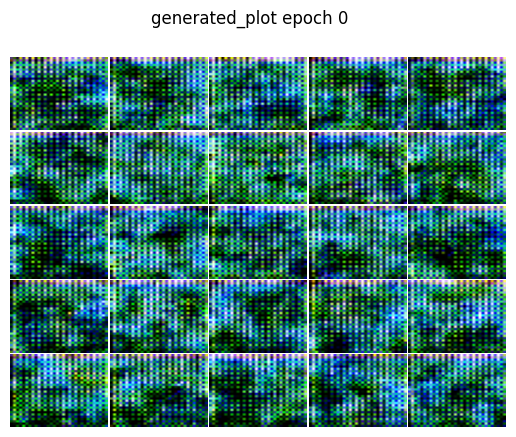

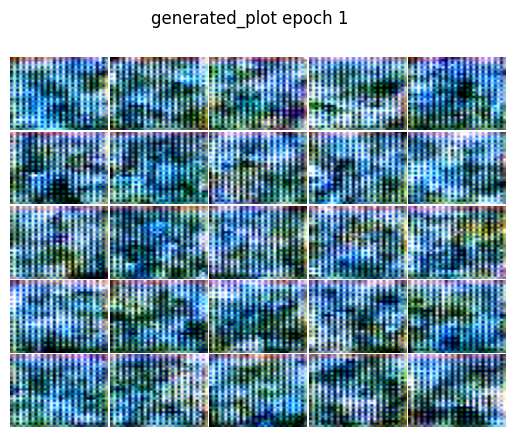

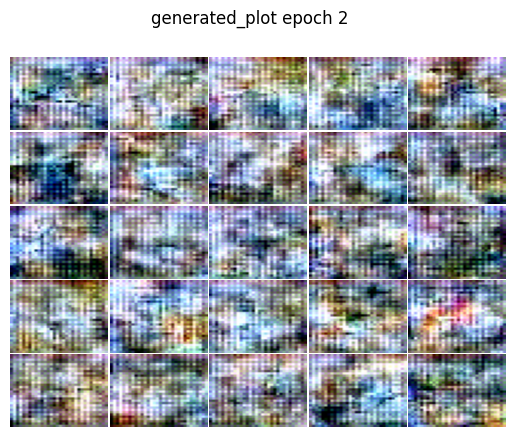

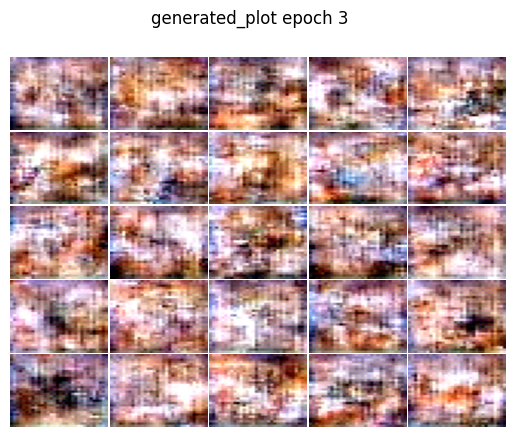

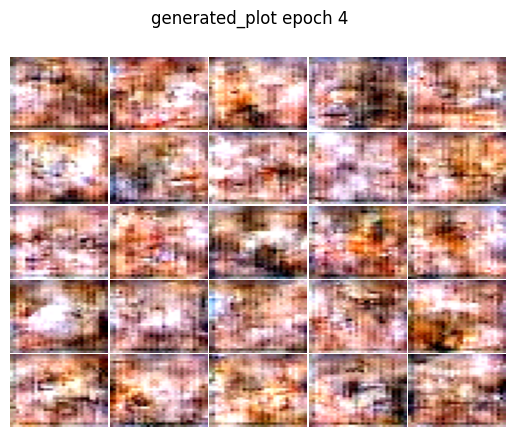

...

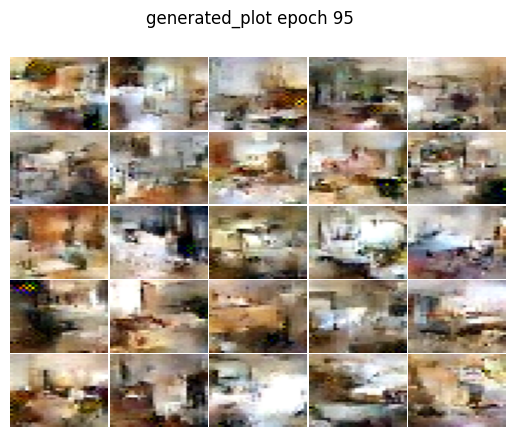

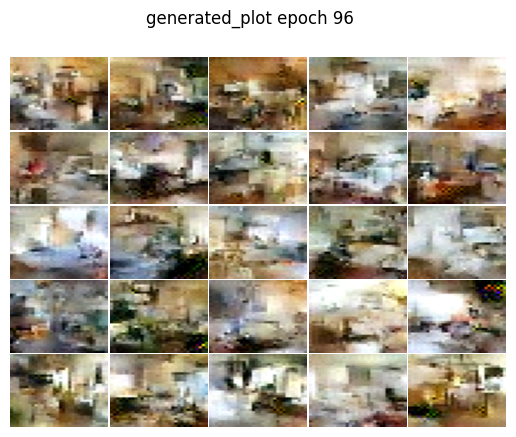

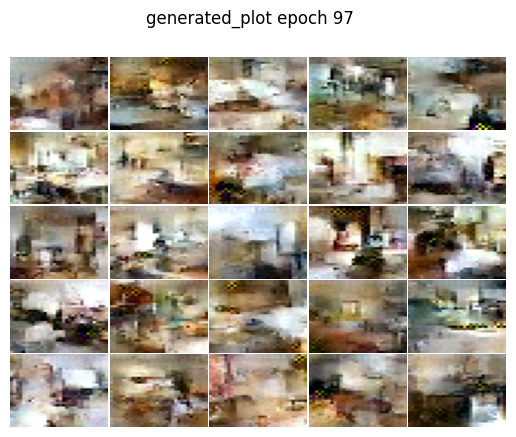

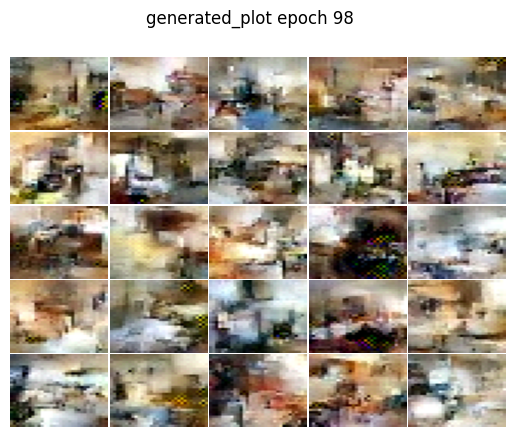

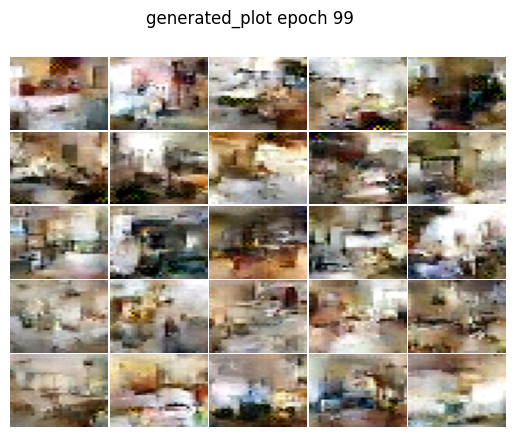

In [14]:
# plotting
n_row, n_column = 5, 5

epochs = 20

loss_per_epoch = []
for e in range(0, epochs + 80):
    loss_per_bath = []
    for i, data in enumerate(dataloader):
        image_batch = data.to(device)
        optimizer.zero_grad()
        z, loss = realnvp(image_batch)
        loss.backward()
        optimizer.step()
        if i % 99 == 0:
            print(f"epcoh {e}, batch {i}, loss {loss}")
        loss_per_bath.append(loss)
    
    epoch_loss = torch.Tensor(loss_per_bath).mean()
    print(f"epoch {e}, loss: {epoch_loss}")
    generated_image = realnvp.sample(n_row * n_column).view(n_row, n_column, 3, 32, 32)
    save_plot(n_row=n_row, n_column=n_column, path="./plots_deeper_resnet_16_blocks", generated_image=generated_image, epoch=e)
    loss_per_epoch.append(epoch_loss)